<a href="https://colab.research.google.com/github/Vany2002/Methods_And_Algorithms_Of_Digital_Image_Processing/blob/main/4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [57]:
!pip install imageai # установка библиотеки ImageAI

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Задание №1. Детекция объектов на изображении

1.1. Перейдите по ссылке из примера №1

1.2. Загрузите готовую модель для детекции объектов на изображении, отличную от той, что представлена в примере

1.3. Используя данную модель, обработе 5 изображений с больши набором объектов, которые относятся к разным классам

1.4. Визуализируйте полученные результаты

In [67]:
import numpy as np
import cv2
import os
from google.colab.patches import cv2_imshow
from urllib.request import urlopen
from imageai.Detection import ObjectDetection

def object_detection(image_link):
    try:
        req = image_link

        image = np.asarray(bytearray(req.read()), dtype=np.uint8) # преобразуем потоковый набор данных в массив numpy
        image = cv2.imdecode(image, -1) # декодируем изображение в привычный для отображения формат

        exec_path = os.getcwd()# Объявляем переменную exec_path и помещаем в неё функцию os.getcwd()для указания пути к данному проекту (для удобства работы с файлами, находящимися в корневой папке проекта)

        detector = ObjectDetection() # создаем объект класса ObjectDetection
        detector.setModelTypeAsYOLOv3() # обращаемся к методу .setModelTypeAsYOLOv3() , тем самым устанавливая для использования в проекте модель yolov3 для распознавания объектов
        detector.setModelPath(r"/content/drive/MyDrive/Модель/yolov3.pt") # указываем путь к модели
        detector.loadModel() # загружаем модель

        list = detector.detectObjectsFromImage( # используем метод detectObjectsFromImage для обнаружения объектов на изображении
            input_image=image, # указываем путь к исходному изображению, либо имя переменной, которая уже содержит изображение
            output_image_path=os.path.join(exec_path, "new_objects.jpg"), # указываем имя и путь для сохранения распознанного изображения
            minimum_percentage_probability=60, # дополнительная характеристика, отвечающая за процент точности распознавания объекта. В данном случае, если точность объекта будет меньше, чем 60%, то в конечной выборке он присутствовать не будет
            display_percentage_probability=True, # отображение процента точности в конечном изображении
            display_object_name=True # отображение класса объекта в конечном изображении
        )

        print(list)
        output_image = cv2.imread("new_objects.jpg")
        cv2_imshow(output_image)

        return "Детекция объектов на изображении произведена"
    except:
        return "Невозможно произвести детекцию объектов на изображении"


[{'name': 'bear', 'percentage_probability': 99.99, 'box_points': [1155, 380, 2079, 1615]}, {'name': 'bear', 'percentage_probability': 99.99, 'box_points': [1592, 387, 2550, 1622]}, {'name': 'bear', 'percentage_probability': 99.52, 'box_points': [518, 180, 1567, 1716]}, {'name': 'bear', 'percentage_probability': 99.92, 'box_points': [56, 279, 927, 1698]}]


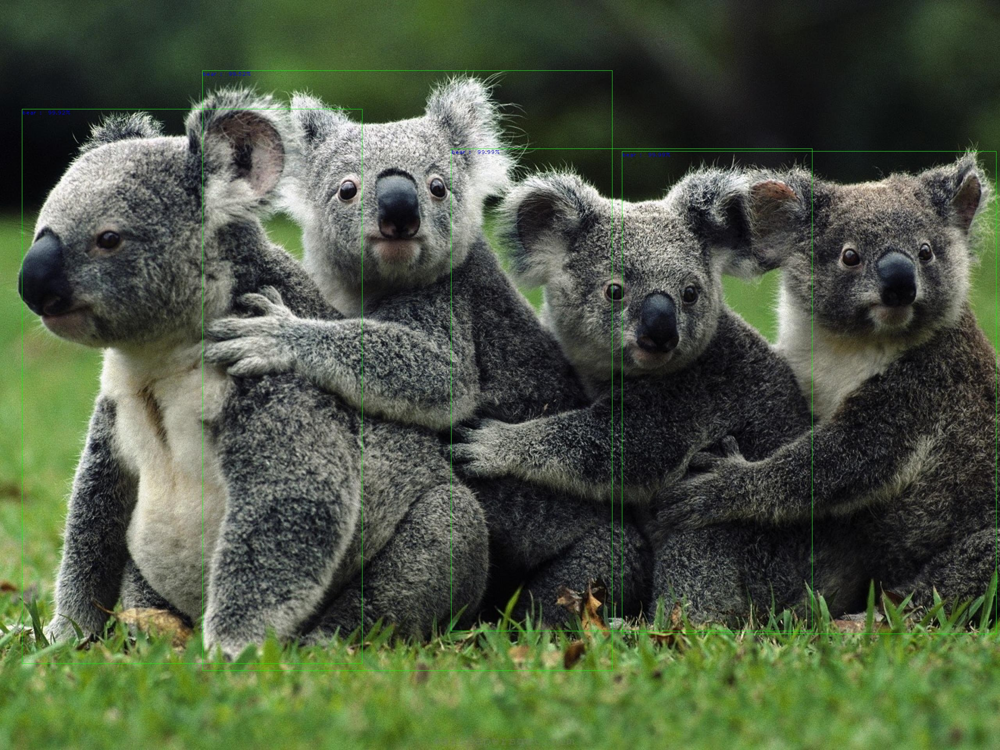

Детекция объектов на изображении произведена


In [68]:
req = urlopen('https://wallup.net/wp-content/uploads/2018/10/09/549104-animals-koalas-australia.jpg')

print(object_detection(req))

[{'name': 'aeroplane', 'percentage_probability': 99.95, 'box_points': [286, 521, 1517, 1089]}, {'name': 'aeroplane', 'percentage_probability': 99.94, 'box_points': [702, 86, 1639, 520]}]


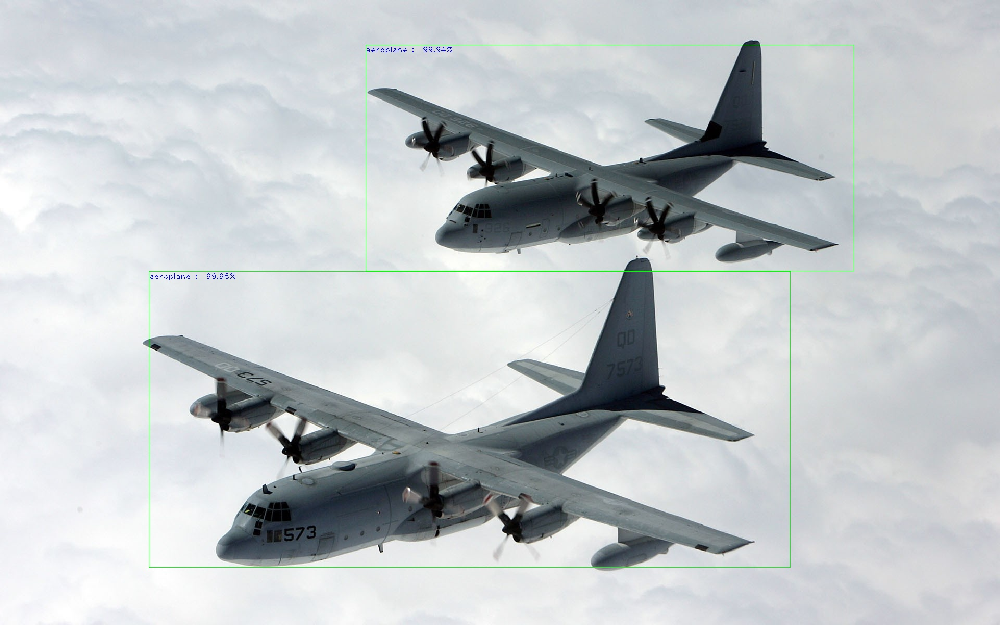

Детекция объектов на изображении произведена


In [69]:
req = urlopen('https://w.forfun.com/fetch/2c/2c580b1a01aafac05520d1ba8b1ce45c.jpeg')

print(object_detection(req))

[{'name': 'car', 'percentage_probability': 98.9, 'box_points': [1052, 276, 1248, 357]}, {'name': 'car', 'percentage_probability': 96.25, 'box_points': [983, 377, 1310, 585]}, {'name': 'car', 'percentage_probability': 92.38, 'box_points': [478, 497, 928, 766]}, {'name': 'car', 'percentage_probability': 98.64, 'box_points': [557, 325, 816, 447]}, {'name': 'car', 'percentage_probability': 99.53, 'box_points': [174, 407, 455, 633]}, {'name': 'car', 'percentage_probability': 97.06, 'box_points': [524, 252, 677, 303]}, {'name': 'car', 'percentage_probability': 92.87, 'box_points': [754, 244, 947, 301]}, {'name': 'car', 'percentage_probability': 99.75, 'box_points': [269, 301, 517, 395]}, {'name': 'car', 'percentage_probability': 97.6, 'box_points': [810, 301, 1023, 395]}]


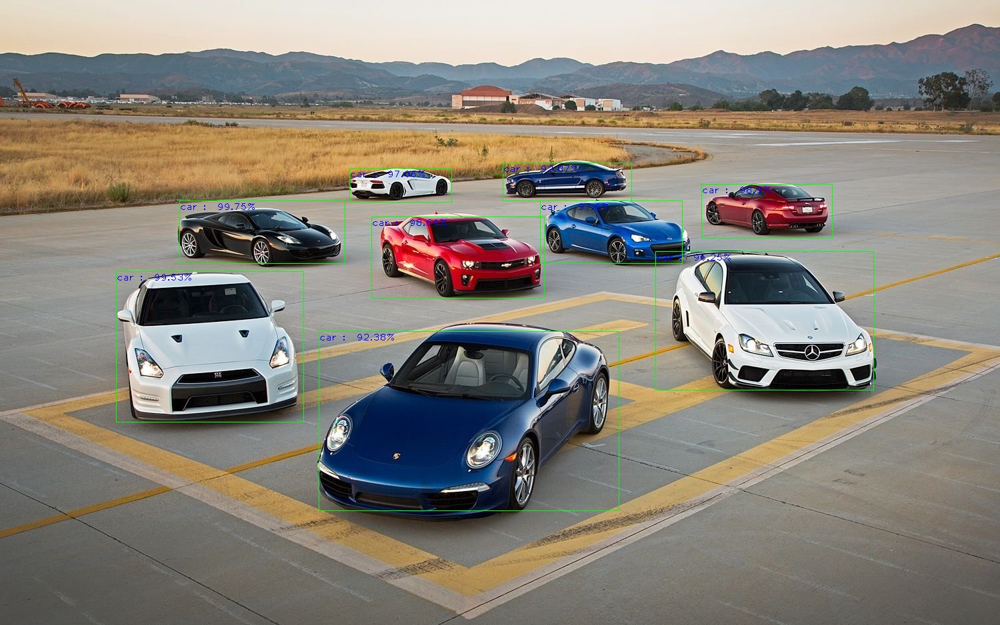

Детекция объектов на изображении произведена


In [70]:
req = urlopen('https://sportishka.com/uploads/posts/2022-11/1667543286_13-sportishka-com-p-samie-nadezhnie-avto-oboi-14.jpg')

print(object_detection(req))

[{'name': 'person', 'percentage_probability': 100.0, 'box_points': [1037, 160, 1238, 875]}, {'name': 'person', 'percentage_probability': 100.0, 'box_points': [237, 173, 486, 880]}, {'name': 'person', 'percentage_probability': 100.0, 'box_points': [448, 166, 695, 883]}, {'name': 'person', 'percentage_probability': 99.99, 'box_points': [30, 155, 297, 903]}, {'name': 'person', 'percentage_probability': 100.0, 'box_points': [808, 142, 1085, 880]}, {'name': 'person', 'percentage_probability': 100.0, 'box_points': [649, 175, 864, 859]}, {'name': 'person', 'percentage_probability': 99.94, 'box_points': [1419, 133, 1672, 839]}, {'name': 'person', 'percentage_probability': 99.97, 'box_points': [1800, 137, 1993, 837]}, {'name': 'person', 'percentage_probability': 99.98, 'box_points': [1620, 148, 1838, 809]}, {'name': 'person', 'percentage_probability': 99.82, 'box_points': [1228, 141, 1467, 883]}, {'name': 'tie', 'percentage_probability': 100.0, 'box_points': [1694, 265, 1725, 376]}, {'name': 't

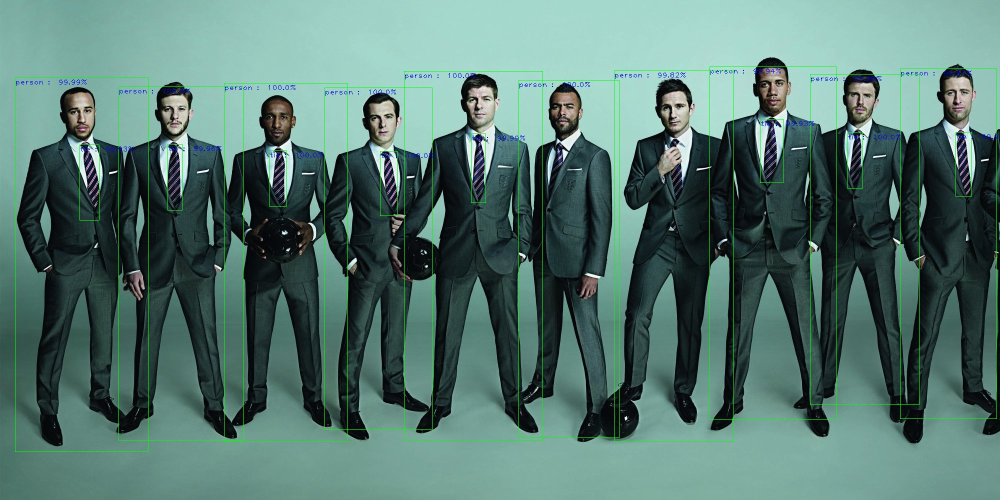

Детекция объектов на изображении произведена


In [71]:
req = urlopen('https://www.wallpaperup.com/uploads/wallpapers/2014/06/02/362492/afd2f5bba5bdc8adaca65ae931f04764.jpg')

print(object_detection(req))

[{'name': 'apple', 'percentage_probability': 99.9, 'box_points': [1342, 902, 2212, 1951]}, {'name': 'apple', 'percentage_probability': 99.65, 'box_points': [286, 1090, 1255, 1930]}, {'name': 'apple', 'percentage_probability': 99.98, 'box_points': [1686, 249, 2590, 1217]}, {'name': 'apple', 'percentage_probability': 99.96, 'box_points': [675, 276, 1712, 1146]}]


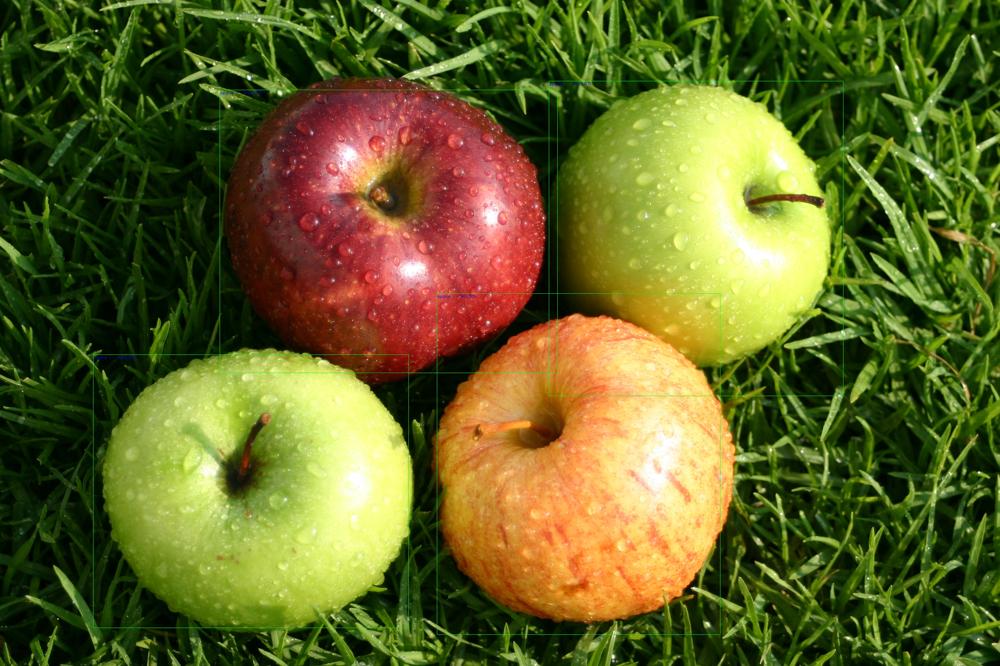

Детекция объектов на изображении произведена


In [72]:
req = urlopen('http://clproduce.com/wp-content/uploads/applegrass.jpg')

print(object_detection(req))